#  Прогнозирование заказов такси

Компания «Чётенькое такси» собрала исторические данные о заказах такси в аэропортах. Чтобы привлекать больше водителей в период пиковой нагрузки, нужно спрогнозировать количество заказов такси на следующий час. Постройте модель для такого предсказания.

Значение метрики *RMSE* на тестовой выборке должно быть не больше 48.

Вам нужно:

1. Загрузить данные и выполнить их ресемплирование по одному часу.
2. Проанализировать данные.
3. Обучить разные модели с различными гиперпараметрами. Сделать тестовую выборку размером 10% от исходных данных.
4. Проверить данные на тестовой выборке и сделать выводы.


Данные лежат в файле `taxi.csv`. Количество заказов находится в столбце `num_orders` (от англ. *number of orders*, «число заказов»).

## Подготовка

In [ ]:
#!pip install xgboost

In [2]:
import time

import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt

from statsmodels.tsa.seasonal import seasonal_decompose

from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error as mse

from sklearn.linear_model import LinearRegression, Ridge, ElasticNet, Lars, Lasso
from xgboost import XGBRegressor

from sklearn.model_selection import RandomizedSearchCV, TimeSeriesSplit

from sklearn.ensemble import RandomForestRegressor

In [3]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
data = pd.read_csv('../datasets/taxi.csv', parse_dates = ['datetime'], index_col=[0])

In [5]:
data.sort_index(inplace=True)

In [6]:
data = data.resample('1H').sum()

## Анализ

In [7]:
data

,num_orders
datetime,
2018-03-01 00:00:00,124
2018-03-01 01:00:00,85
2018-03-01 02:00:00,71
2018-03-01 03:00:00,66
2018-03-01 04:00:00,43
...,...
2018-08-31 19:00:00,136
2018-08-31 20:00:00,154
2018-08-31 21:00:00,159


In [8]:
data.describe()

,num_orders
count,4416.000000
mean,84.422781
std,45.023853
min,0.000000
25%,54.000000
50%,78.000000
75%,107.000000
max,462.000000


In [9]:
data.isnull().sum()

num_orders    0
dtype: int64

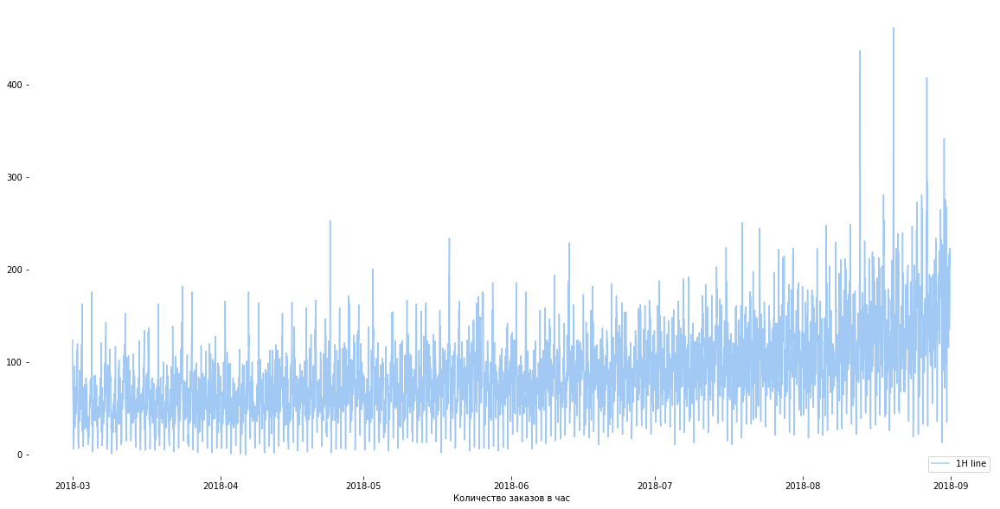

In [10]:
f, ax = plt.subplots(figsize=(20, 10))


sns.set_color_codes("pastel")
sns.lineplot(x="datetime", y="num_orders", data=data,
            label="1H line", color="b")

ax.legend(ncol=1, loc="lower right", frameon=True)
ax.set(ylabel="",
       xlabel="Количество заказов в час")
sns.despine(left=True, bottom=True)

In [11]:
dec = seasonal_decompose(data)

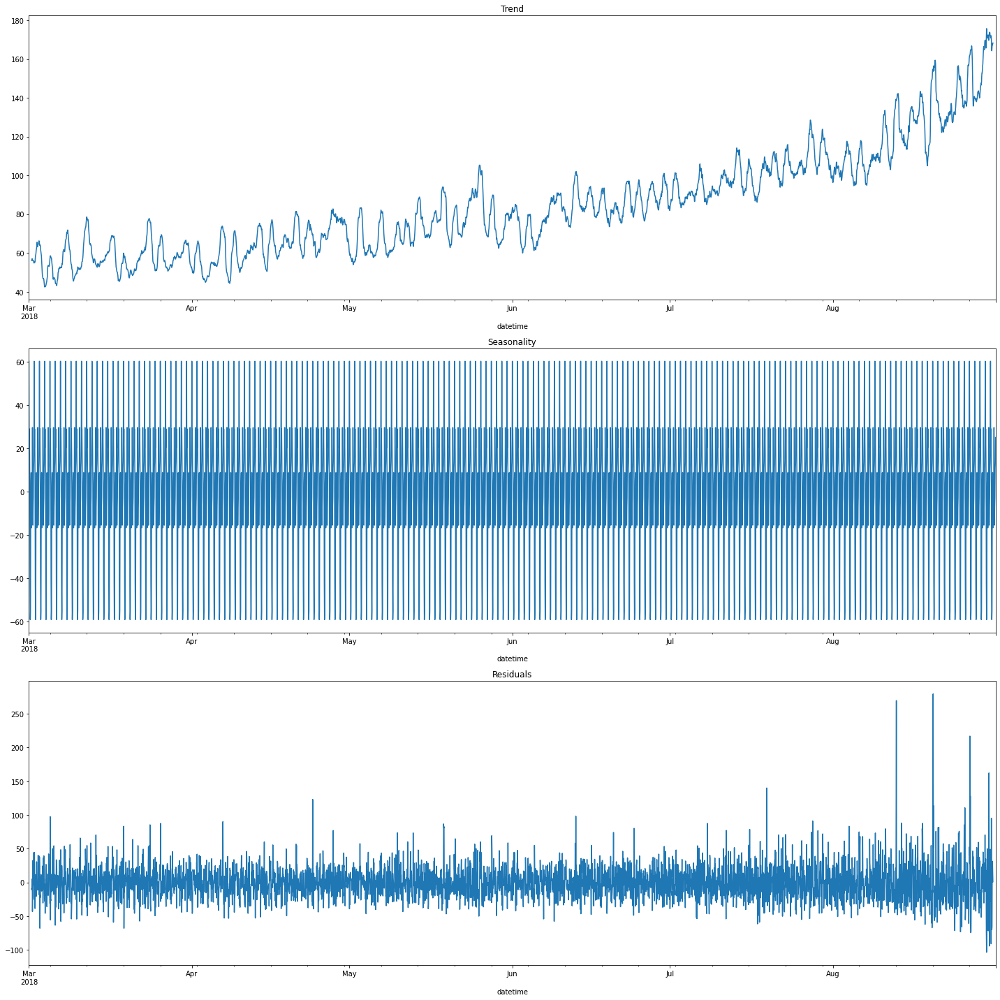

In [12]:
plt.figure(figsize=(20, 20))

plt.subplot(311)
dec.trend.plot(ax=plt.gca())
plt.title('Trend')

plt.subplot(312)
dec.seasonal.plot(ax=plt.gca())
plt.title('Seasonality')

plt.subplot(313)
dec.resid.plot(ax=plt.gca())
plt.title('Residuals')

plt.tight_layout()

**Вывод**

Видим тренд увеличения заказов такси к концу лета:
- начало учебы
- много людей возвращаются из отпуска

Для оценки сезонных колебаний - необходимо сделать срез поменьше

In [13]:
season_zoom = dec.seasonal['2018-05-01':'2018-05-02']

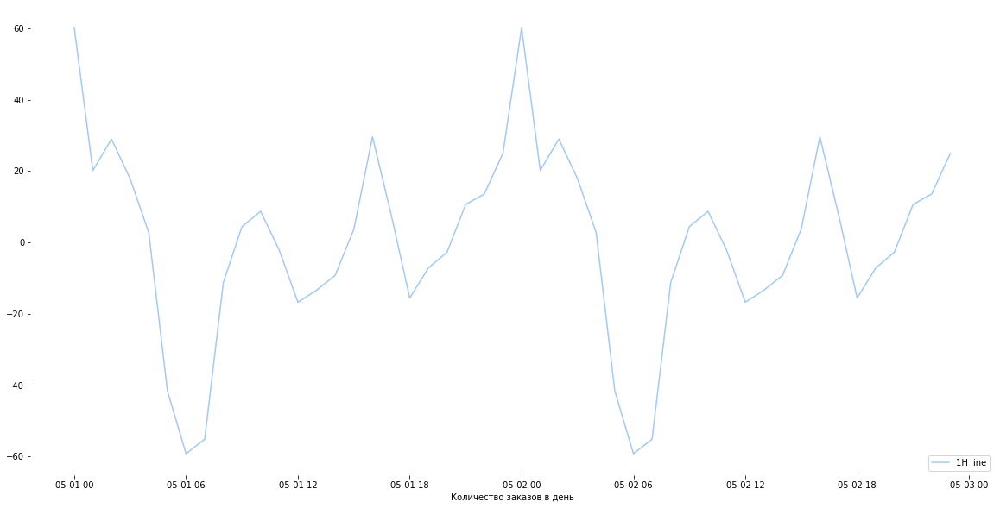

In [14]:
f, ax = plt.subplots(figsize=(20, 10))


sns.set_color_codes("pastel")
sns.lineplot(data=season_zoom,
            label="1H line", color="b")

ax.legend(ncol=1, loc="lower right", frameon=True)
ax.set(ylabel="",
       xlabel="Количество заказов в день")
sns.despine(left=True, bottom=True)

**Вывод**

Видим, что пик заказов приходится на полночь

Так же высокий спрос во время обеда (бизнес ланчи и прочее))

Так же с 7 утра и до 11 - люди добираются на работу/учебу

## Обучение

Нагенерим фичи для нашего датасета

In [15]:
def features_creation(data_in, max_lag, roll_mean_size):
    '''
    Функция принимает на вход:
    - data_in - объект типа DataFrame - датасет для добавление фичей
    - max_lag - число тип int - размер сдвига
    - roll_mean_size - число типа int - размер окна
    
    data_out - копия входных данных
    Функция создает, на основе имеющихся данных, еовые фичи
    Добавляет колонки со сдвигом в Год, Месяц, Неделю и Дня недели
    Так же добавляет скользящее среднее по размеру заданного окна

    Возвращает data_out - DataFrame с новыми фичами
    '''

    data_out = data_in.copy()

    data_out['year'] = data_out.index.year
    data_out['month'] = data_out.index.month
    data_out['week'] = data_out.index.week
    data_out['dayofweek'] = data_out.index.dayofweek
    
    for lag in range(1, max_lag + 1):
        data_out['lag_{}'.format(lag)] = data_out['num_orders'].shift(lag)
        
    data_out['rolling_mean'] = data_out['num_orders'].shift().rolling(roll_mean_size).mean()
    
    return data_out
  

In [16]:
# Делим датасет на три части
target = 'num_orders'
train, valid = train_test_split(data, shuffle=False, test_size = 0.2)
valid, test = train_test_split(valid, shuffle=False, test_size = 0.5)

In [17]:
train.shape

(3532, 1)

In [18]:
valid.shape

(442, 1)

In [19]:
test.shape

(442, 1)

### Константная модель

In [20]:
print('Среднее колличество заказов в час:', valid['num_orders'].mean())
pred_previous = valid['num_orders'].shift(fill_value=train['num_orders'].iloc[-1])
#print(pred_previous)
print('RMSE:', mse(valid['num_orders'], pred_previous, squared=False))

Среднее колличество заказов в час: 110.11990950226244
RMSE: 47.246345832986236


**Вывод**

Константное значение есть, а значит ориентир тоже

Можем перейти к моделям

#### Функция подбора фичей

In [21]:
def plot_test(preds, test, rmse):    
    plt.figure(figsize=(20, 10))
    plt.plot(preds, "r", label="prediction", linewidth=2.0)
    plt.plot(test.values, label="actual", linewidth=1.0)

    plt.title("RMSE {0:.2f}".format(rmse))
    plt.legend(loc="best")
    plt.tight_layout()
    plt.grid(True)

In [22]:
def search(train_data, valid_data, model):
    '''
    Функция принимает на вход:
    - train_data - объект типа DataFrame - набор обучающих данных
    - valid_data - объект типа DataFrame - набор валидационных данных
    - model - модель обучения
    
    Внутри функция проходит цикл в цикле и на каждой итерации считает основную метрику RMSE
    
    Внутри цикла вызывает функцию features_creation и добавляет новые фичи, по заданным индексам цикла
    
    На каждой итерации, при улучшения метрики, сохраняет актуальные значения lag и roll

    Выводит график сравнения лучшего предсказания и валидации
    '''
    
    min_lag = 1
    max_lag = 70
    min_roll = 1
    max_roll = 70
    
    best_rmse = 10000
    best_lag = 0
    best_roll = 0
    
    lag_list = range(min_lag, max_lag)
    roll_list = range(min_roll, max_roll)
    
    best_pred = None
    actual_valid = None
    
    for lag in lag_list:
        for roll in roll_list:
            
            # Создаем новые фичи во время перебора
            train = features_creation(train_data, lag, roll)
            valid = features_creation(valid_data, lag, roll)
            
            train = train.dropna()
            valid = valid.dropna()
            
            X_train = train.drop('num_orders', axis=1)
            X_valid = valid.drop('num_orders', axis=1)
            
            y_train = train[target]
            y_valid = valid[target]
            
            model.fit(X_train, y_train)
            
            pred = model.predict(X_valid)
            rmse = mse(y_valid, pred, squared=False)
            
            
            if best_rmse > rmse:
                best_rmse = rmse
                best_lag = lag
                best_roll = roll
                best_pred = pred
                actual_valid = y_valid
                
    print(f'RMSE: {best_rmse}')
    print(f'LAG num: {best_lag}')
    print(f'ROLL num: {best_roll}')


    # Вывод графика
    plot_test(best_pred, actual_valid, best_rmse)
    
    
    return best_rmse, best_lag, best_roll
            

### Линейная регрессия

In [23]:
model = LinearRegression()

RMSE: 31.24425045741636
LAG num: 49
ROLL num: 2
CPU times: user 32min 56s, sys: 13min 28s, total: 46min 25s
Wall time: 5min 2s


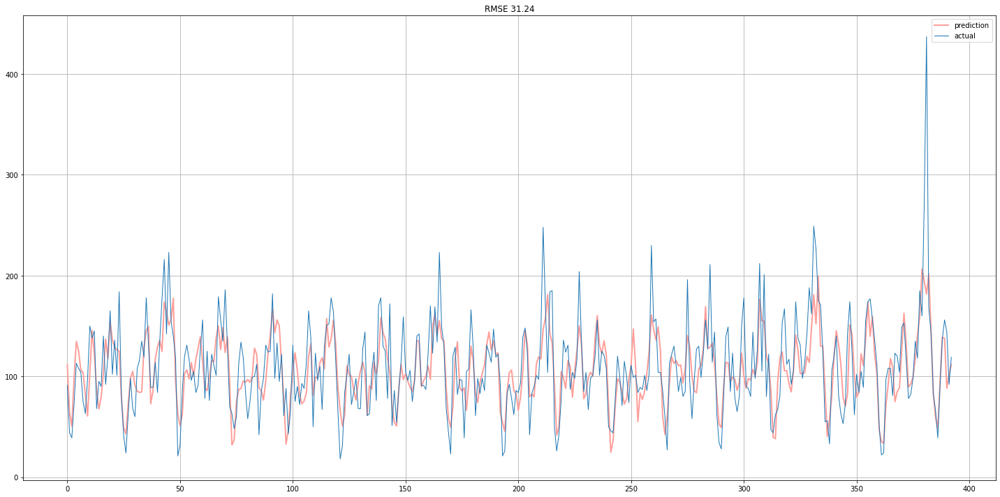

In [24]:
%%time
LR = search(train, valid, model)

### RandomForest

In [25]:
rf_m = RandomForestRegressor(n_jobs=-1)

#### RandomForest без перебора

RMSE: 31.36510208609867
LAG num: 61
ROLL num: 6
CPU times: user 14h 45min 53s, sys: 6min 56s, total: 14h 52min 49s
Wall time: 1h 31min 23s


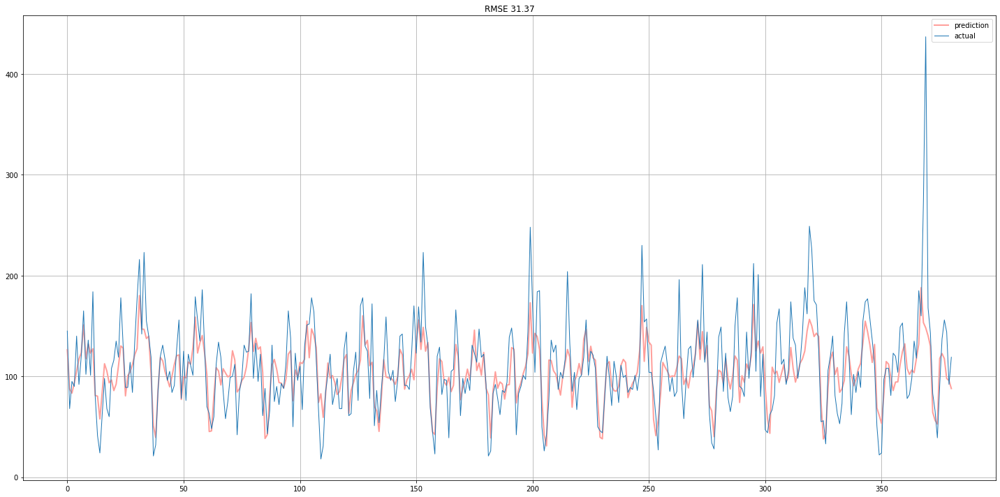

In [26]:
%%time
RF = search(train, valid, rf_m)

In [27]:
rf_m.get_params()

{'bootstrap': True,
 'ccp_alpha': 0.0,
 'criterion': 'mse',
 'max_depth': None,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 100,
 'n_jobs': -1,
 'oob_score': False,
 'random_state': None,
 'verbose': 0,
 'warm_start': False}

#### RandomForest с перебором

In [28]:
tscv = TimeSeriesSplit(n_splits=3)

In [29]:
max_depth = [x for x in range(1, 20, 5)]
n_estimators = [x for x in range(1, 20, 5)]

params = {'max_depth' : max_depth,
          'n_estimators' : n_estimators,
          "min_samples_split": np.arange(2,20,2),
          "min_samples_leaf" : np.arange(1,20,2)}

rs = RandomizedSearchCV(rf_m,
                        params,
                        n_iter = 4,
                        verbose = 0,
                        n_jobs = -1,
                        cv = tscv
                        )



RMSE: 32.053691230593635
LAG num: 53
ROLL num: 17
CPU times: user 51min 49s, sys: 48.8 s, total: 52min 38s
Wall time: 33min 28s


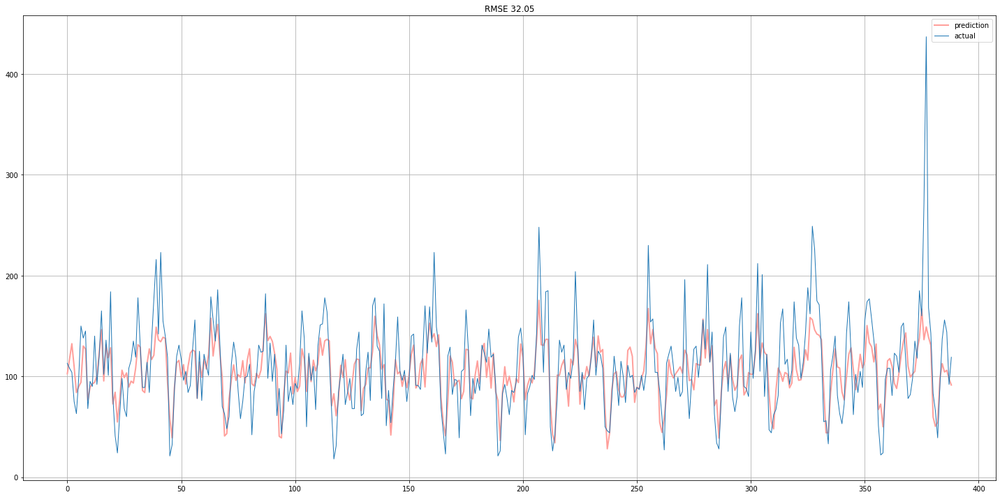

In [30]:
%%time
RF_RS = search(train, valid, rs)

### Ridge

In [31]:
ridge_m = Ridge()

RMSE: 31.260910321598452
LAG num: 48
ROLL num: 49


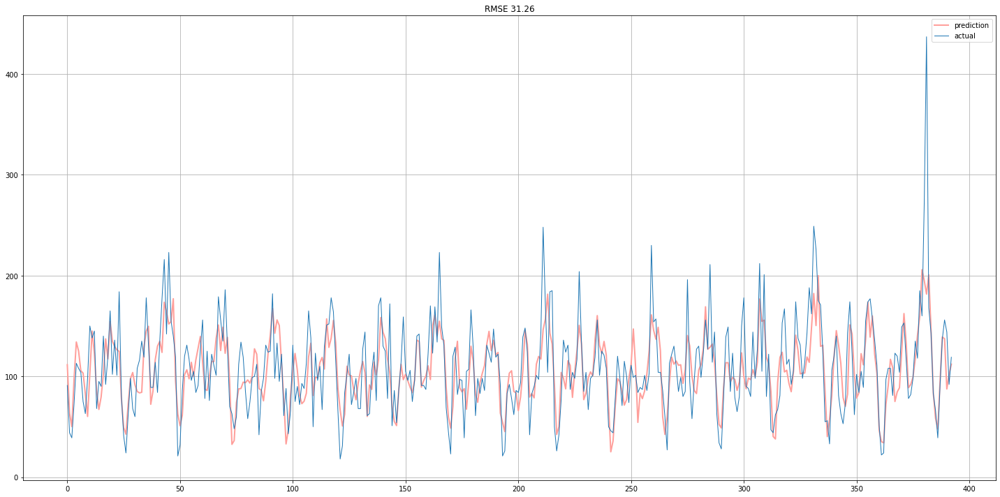

In [32]:
RIDGE = search(train, valid, ridge_m)

#### Ridge с перебором

In [33]:
ridge_m.get_params()

{'alpha': 1.0,
 'copy_X': True,
 'fit_intercept': True,
 'max_iter': None,
 'normalize': False,
 'random_state': None,
 'solver': 'auto',
 'tol': 0.001}

In [34]:
params = {'alpha': [1.0, 0.5, 0.1],
          'copy_X': [True, False],
          'fit_intercept': [True, False],
          'max_iter': [None, 4, 8],
          'normalize': [True, False],
          'tol': [0.001, 0.0001]}

ridge_rs = RandomizedSearchCV(ridge_m,
                              params,
                              verbose = 0,
                              n_jobs = -1,
                              cv = tscv
                              )

RMSE: 31.143360249924918
LAG num: 49
ROLL num: 1


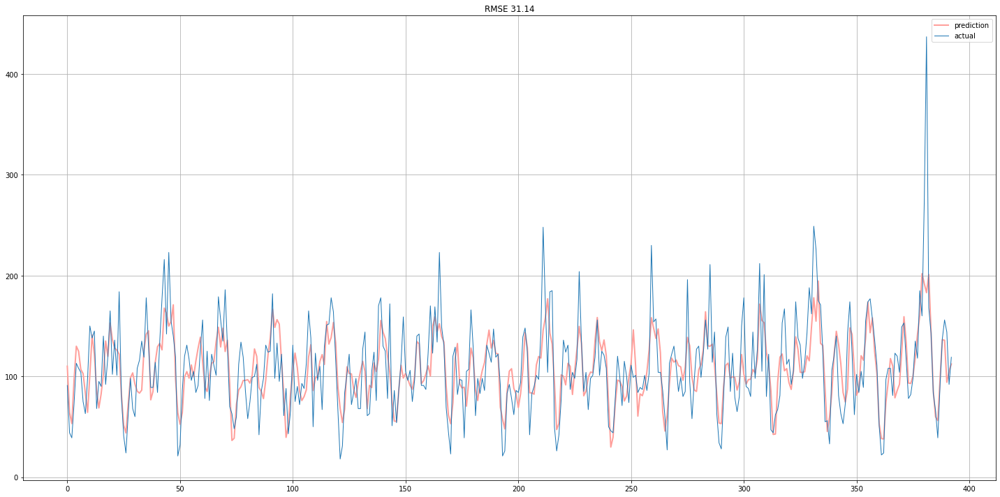

In [35]:
RIDGE_RS = search(train, valid, ridge_rs)

### Lars

In [36]:
lars_m = Lars(n_nonzero_coefs=1, normalize=False)

RMSE: 44.35327203853292
LAG num: 1
ROLL num: 1


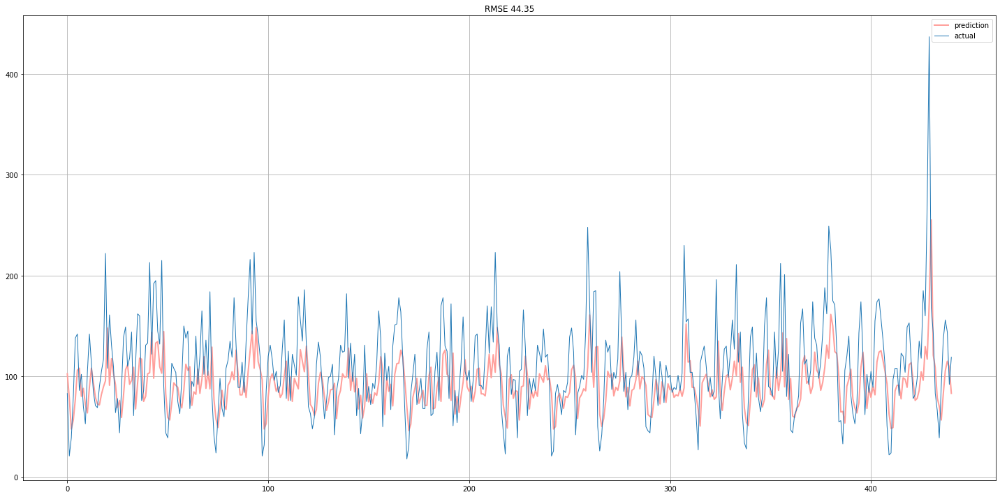

In [37]:
LARS = search(train, valid, lars_m)

#### Lars с перебором 

In [38]:
lars_m.get_params()

{'copy_X': True,
 'eps': 2.220446049250313e-16,
 'fit_intercept': True,
 'fit_path': True,
 'jitter': None,
 'n_nonzero_coefs': 1,
 'normalize': False,
 'precompute': 'auto',
 'random_state': None,
 'verbose': False}

In [39]:
params = {'copy_X': [True, False],
          'fit_intercept': [True, False],
          'fit_path': [True, False],
          'jitter': [None, 2],
          'n_nonzero_coefs': [1, 3],
          'normalize': [False, True]
          }

lars_rs = RandomizedSearchCV(lars_m,
                              params,
                              verbose = 0,
                              n_jobs = -1,
                              cv = tscv
                              )

/opt/anaconda3/envs/practicum/lib/python3.9/site-packages/sklearn/linear_model/_least_angle.py:615: ConvergenceWarning: Regressors in active set degenerate. Dropping a regressor, after 2 iterations, i.e. alpha=2.117e+01, with an active set of 2 regressors, and the smallest cholesky pivot element being 2.220e-16. Reduce max_iter or increase eps parameters.
  warnings.warn('Regressors in active set degenerate. '
/opt/anaconda3/envs/practicum/lib/python3.9/site-packages/sklearn/linear_model/_least_angle.py:615: ConvergenceWarning: Regressors in active set degenerate. Dropping a regressor, after 2 iterations, i.e. alpha=6.041e-01, with an active set of 2 regressors, and the smallest cholesky pivot element being 2.220e-16. Reduce max_iter or increase eps parameters.
  warnings.warn('Regressors in active set degenerate. '
/opt/anaconda3/envs/practicum/lib/python3.9/site-packages/sklearn/linear_model/_least_angle.py:615: ConvergenceWarning: Regressors in active set degenerate. Dropping a regr

RMSE: 36.15851992058775
LAG num: 47
ROLL num: 49


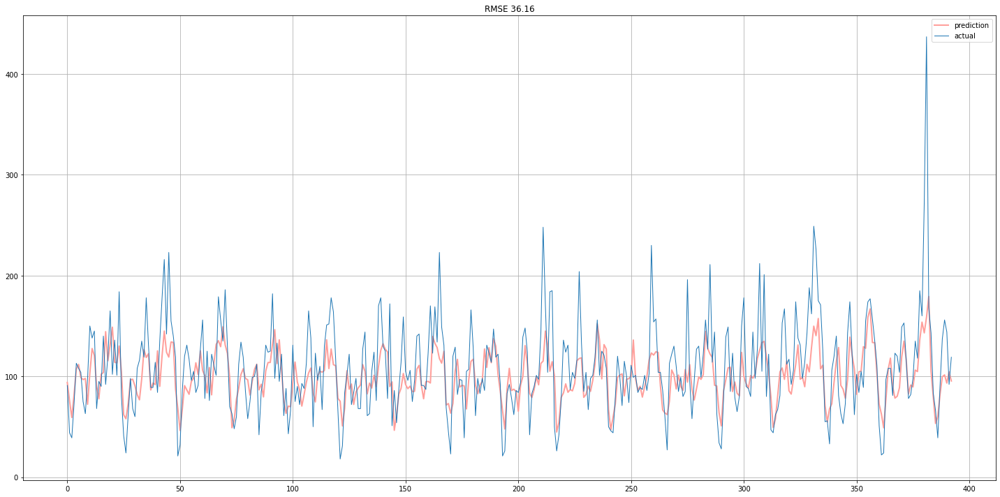

In [40]:
LARS_RS = search(train, valid, lars_rs)

### ElasticNet

In [41]:
en_model = ElasticNet()

RMSE: 31.194985544024313
LAG num: 48
ROLL num: 49


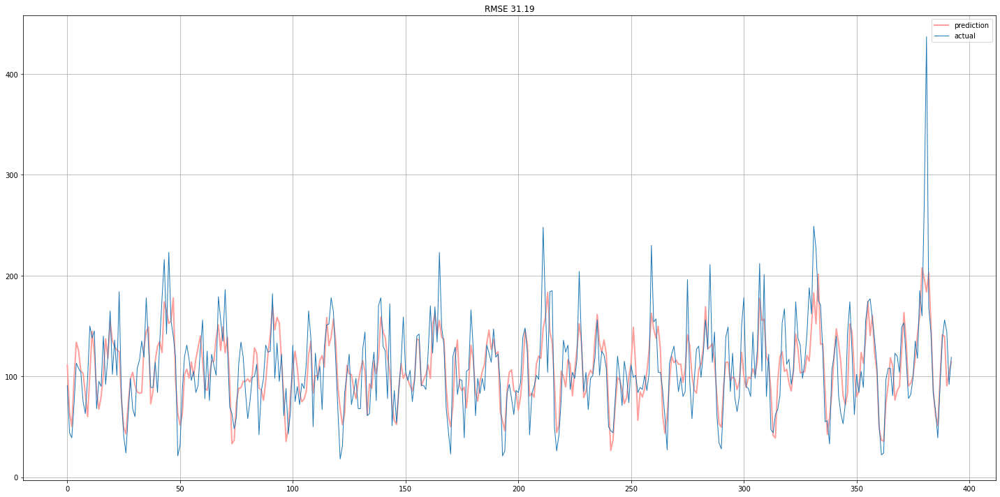

In [42]:
ENet = search(train, valid, en_model)

#### ElasticNet с перебором

In [43]:
en_model.get_params()

{'alpha': 1.0,
 'copy_X': True,
 'fit_intercept': True,
 'l1_ratio': 0.5,
 'max_iter': 1000,
 'normalize': False,
 'positive': False,
 'precompute': False,
 'random_state': None,
 'selection': 'cyclic',
 'tol': 0.0001,
 'warm_start': False}

In [44]:
params = {'alpha': [1.0, 2.0, 0.1],
          'copy_X': [True, False],
          'fit_intercept': [True, False],
          'l1_ratio': [0.5, 0.1, 1.0, 0.01],
          'max_iter': [500, 1000, 1500],
          'positive': [False, True],
          'precompute': [False, True],
          'tol': [0.0001, 0.00001],
          'warm_start': [False, True]}

en_rs = RandomizedSearchCV(en_model,
                              params,
                              verbose = 0,
                              n_jobs = -1,
                              cv = tscv
                              )

/opt/anaconda3/envs/practicum/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 123345.679117458, tolerance: 36.20047
  model = cd_fast.enet_coordinate_descent_gram(
/opt/anaconda3/envs/practicum/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 194355.81962315226, tolerance: 83.81951000000001
  model = cd_fast.enet_coordinate_descent_gram(
/opt/anaconda3/envs/practicum/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24311.39320072229, tolerance: 17.072610164119972
  model = cd_fast.enet_coordinate_descent(
/opt/anaconda3/envs/practicum/lib/python3.9/site-packages/skle

RMSE: 31.18847756881611
LAG num: 49
ROLL num: 40


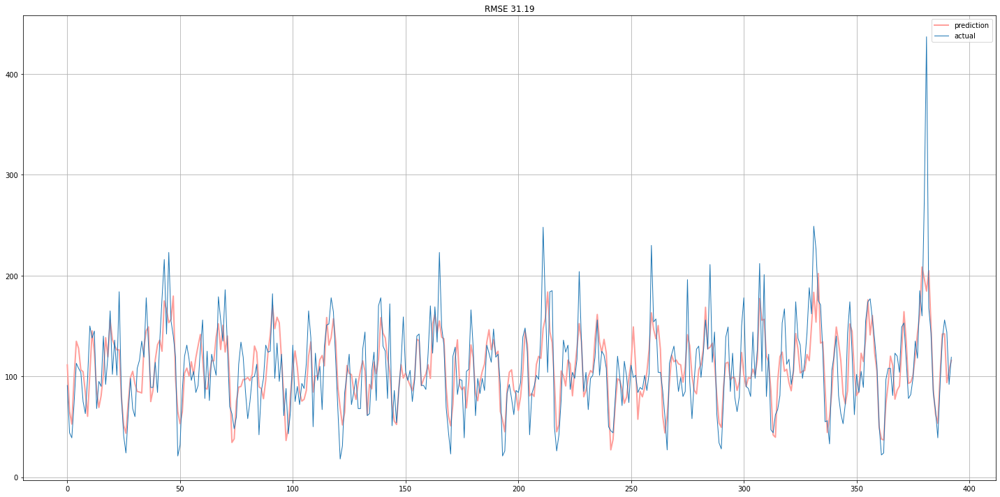

In [45]:
EN_RS = search(train, valid, en_rs)

### Lasso

In [46]:
lasso_m = Lasso(alpha=0.1)

RMSE: 31.2193736950954
LAG num: 48
ROLL num: 49


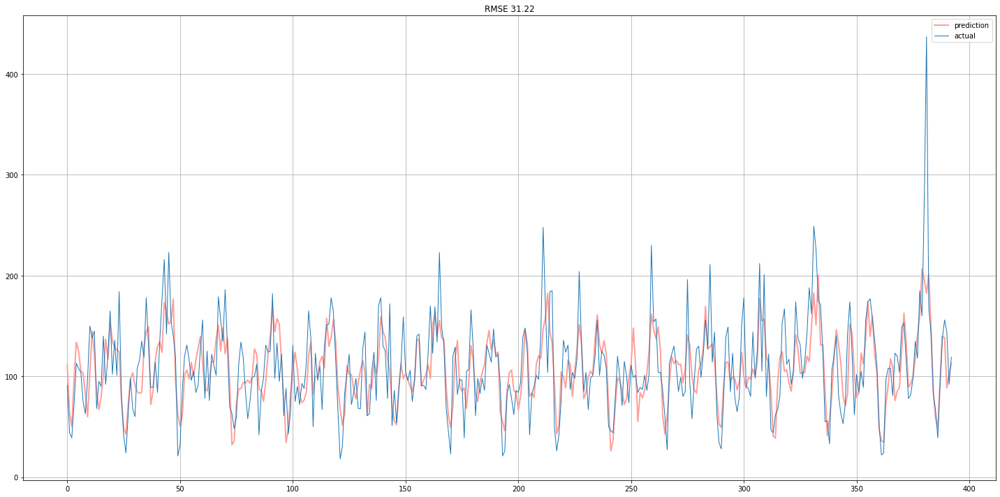

In [47]:
LASSO = search(train, valid, lasso_m)

#### Lasso с перебором

In [48]:
lasso_m.get_params()

{'alpha': 0.1,
 'copy_X': True,
 'fit_intercept': True,
 'max_iter': 1000,
 'normalize': False,
 'positive': False,
 'precompute': False,
 'random_state': None,
 'selection': 'cyclic',
 'tol': 0.0001,
 'warm_start': False}

In [49]:
params = {'alpha': [0.1, 0.5, 1.0],
          'copy_X': [True, False],
          'fit_intercept': [True, False],
          'max_iter': [500, 1000, 2000],
          'positive': [False, True],
          'precompute': [False, True],
          'tol': [0.0001, 0.00001],
          'warm_start': [False, True]}

lasso_rs = RandomizedSearchCV(lasso_m,
                              params,
                              verbose = 0,
                              n_jobs = -1,
                              cv = tscv
                              )

/opt/anaconda3/envs/practicum/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 673.6204779585823, tolerance: 150.43370000000002
  model = cd_fast.enet_coordinate_descent_gram(
/opt/anaconda3/envs/practicum/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 49623.658054749016, tolerance: 836.9685000000001
  model = cd_fast.enet_coordinate_descent_gram(
/opt/anaconda3/envs/practicum/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 491930.7997470915, tolerance: 1504.337
  model = cd_fast.enet_coordinate_descent_gram(
/opt/anaconda3/envs/practicum/lib/python3.9/site-package

RMSE: 31.183472662459074
LAG num: 49
ROLL num: 19


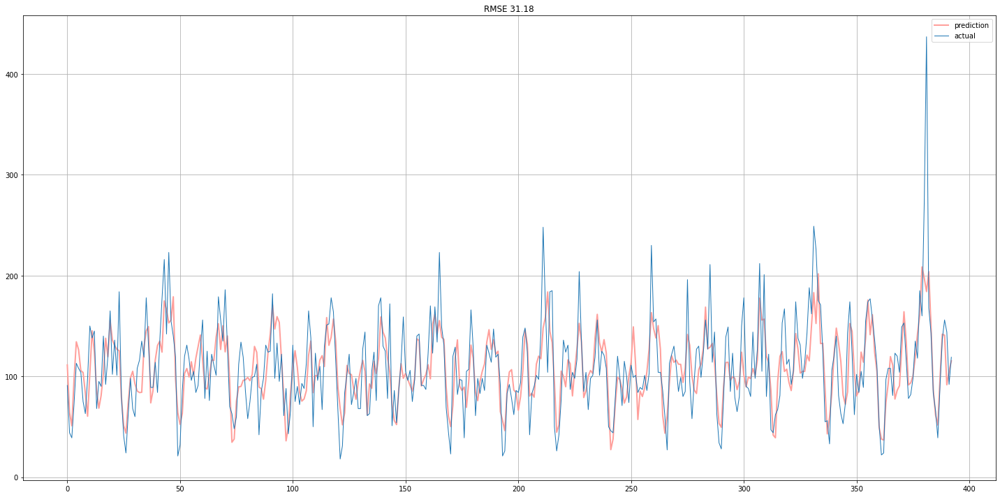

In [50]:
LASSO_RS = search(train, valid, lasso_rs)

### Попробуем бустинг!)

In [51]:
xgb = XGBRegressor(verbosity=0)

RMSE: 30.71593041957114
LAG num: 55
ROLL num: 24
CPU times: user 6h 13min 32s, sys: 2min 13s, total: 6h 15min 46s
Wall time: 31min 45s


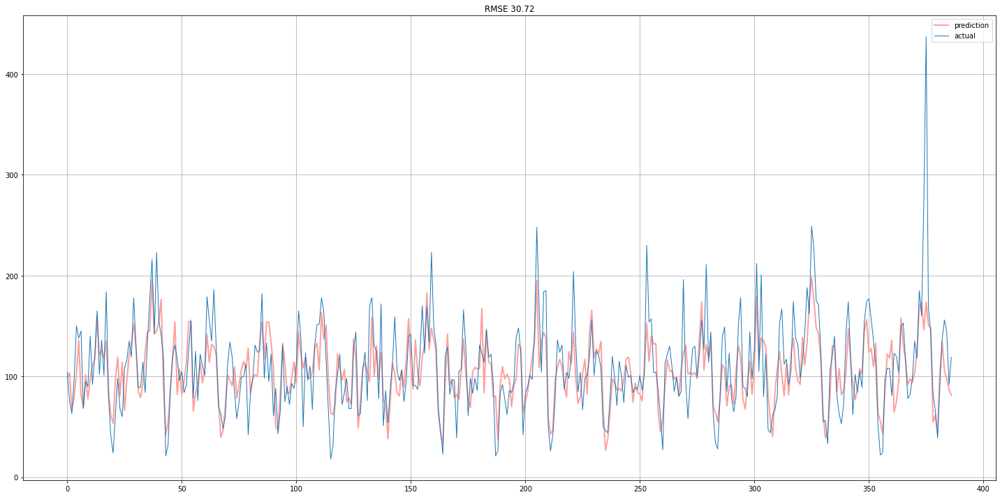

In [52]:
%%time
XGB = search(train, valid, xgb)

## Соберем все результаты в единую таблицу

In [63]:
d = pd.DataFrame([LR, RIDGE, LARS, ENet, 
                  LASSO, RF, RF_RS, RIDGE_RS, 
                  LARS_RS, EN_RS, LASSO_RS, XGB], 
                 
                 columns=['RMSE', 'LAG', 'ROLL'], 
                 index=['LR', 'RIDGE', 'LARS', 'ENet', 
                        'LASSO', 'RF', 'RF_RS', 'RIDGE_RS', 
                        'LARS_RS', 'EN_RS', 'LASSO_RS', 'XGB'])

d.sort_values(by='RMSE')

,RMSE,LAG,ROLL
XGB,30.715930,55,24
RIDGE_RS,31.143360,49,1
LASSO_RS,31.183473,49,19
EN_RS,31.188478,49,40
ENet,31.194986,48,49
LASSO,31.219374,48,49
LR,31.244250,49,2
RIDGE,31.260910,48,49
RF,31.365102,61,6
RF_RS,32.053691,53,17


In [65]:
d = d.reset_index()[['index', 'RMSE']]
d = d.rename(columns = {'index' : 'MODEL'})

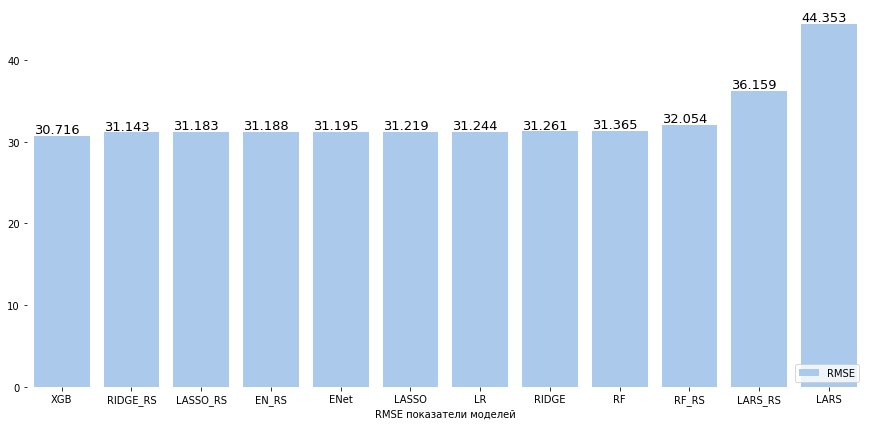

In [68]:
f, ax = plt.subplots(figsize=(15, 7))


sns.set_color_codes("pastel")
sns.barplot(x="MODEL", y='RMSE', data=round(d.sort_values(by='RMSE'), 3),
            label="RMSE", color="b")

ax.legend(ncol=1, loc="lower right", frameon=True)
ax.set(ylabel="",
       xlabel="RMSE показатели моделей")
sns.despine(left=True, bottom=True)

for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x(), p.get_height() * 1.01), size=13)

**Вывод**

Лучший результат показал XGBoost

Проверим на тестовых данных

## Тестирование

#### Тестирование лучшей модели

In [56]:
best_EN = en_rs.best_estimator_

In [57]:
train_best_m = features_creation(train, XGB[1], XGB[2])
train_best_m = train_best_m.dropna()

X_train = train_best_m.drop('num_orders', axis=1)
y_train = train_best_m[target]

xgb.fit(X_train, y_train)


test_best_m = features_creation(test, XGB[1], XGB[2])
test_best_m = test_best_m.dropna()

X_test = test_best_m.drop('num_orders', axis=1)
y_test = test_best_m[target]

test_preds_best_m = xgb.predict(X_test)

test_rmse_best_m = mse(y_test, test_preds_best_m, squared=False)

print(round(test_rmse_best_m, 2))

48.74


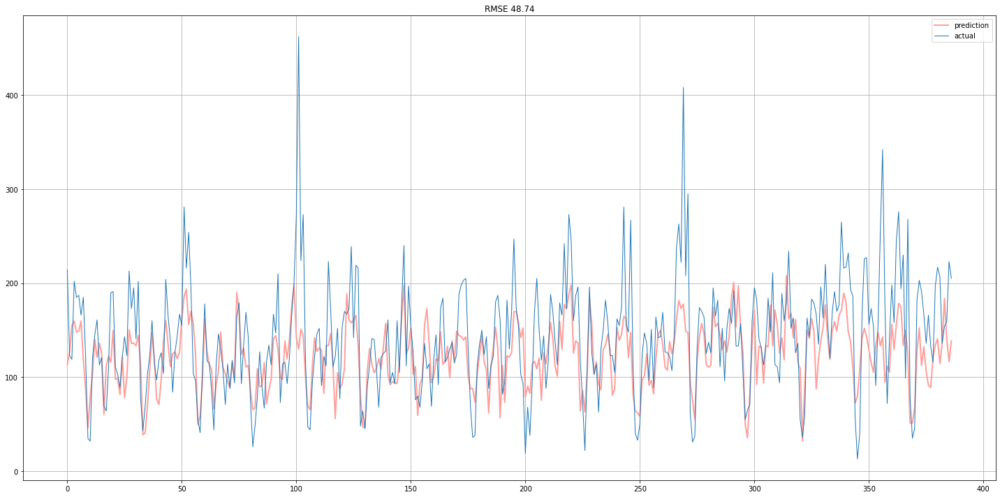

In [58]:
plot_test(test_preds_best_m, y_test, test_rmse_best_m)

#### Тестирование лучшей модели на объединенном датасете

In [59]:
un_train, un_test = train_test_split(data, shuffle=False, test_size=0.1)

un_train = features_creation(un_train, XGB[1], XGB[2])
un_train = un_train.dropna()

X_train = un_train.drop('num_orders', axis=1)
y_train = un_train[target]

xgb.fit(X_train, y_train)


un_test = features_creation(un_test, XGB[1], XGB[2])
un_test = un_test.dropna()

X_test = un_test.drop('num_orders', axis=1)
y_test = un_test[target]

test_preds_un = xgb.predict(X_test)

test_rmse_un = mse(y_test, test_preds_un, squared=False)

print(round(test_rmse_un, 2))

43.21


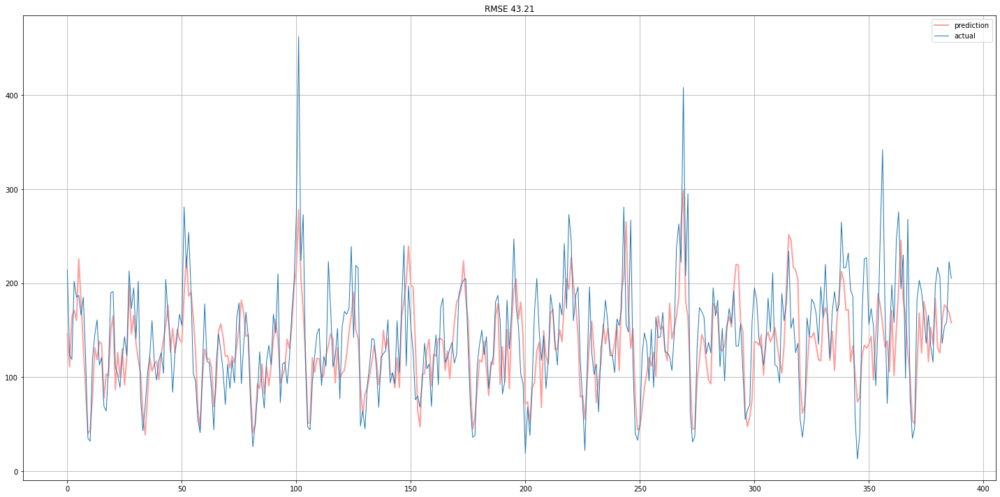

In [60]:
plot_test(test_preds_un, y_test, test_rmse_un)

**Вывод**

На тестовой выборке наша модель работает

- Данные осмотрены
- Обработаны
- Произведен подбор параметров
- Затестили несколько моделей и нашли лучшую
- Проверил на тестовой выборке лучшую модель
- Получилось добиться метрики в 43.21 при объединенном датасете


Бустинг показал лучший резельтат среди всех моделей